# 1. Data Preparation
The first major task is to access and evaluate the data. The Data, to be used is coming from several sources and contains information about each user's subscription and streaming activities.

1.   User Profile data: **members.csv**. This data includes the user persona like user’s age, city and their registration time.
2.   User Logs data: **user_logs.csv**. This data consist of each user's listening behaviour in terms of their songs played in each day
3.   User Transaction data:  **transations.csv**. This data consist of details like payment method or whether the subscription was cancelled.
4.   Historical data: **train.csv** . This data consists of user IDs and whether these users have churned or not.


In [5]:
#make sure your path is set to source folder
%cd /Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge

/Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge


In [7]:
!pwd

/Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge


In [9]:
# Setting up all directory
root_folder = "/Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge"

data_directory = root_folder+"/data/new/"
data_profile_path = root_folder+"/data/profile_report/"
intermediate_data_path = root_folder+"/data/interim/"
print("directory loaded")

directory loaded


### 1.1 Importing packages

In [12]:
import warnings
warnings.filterwarnings("ignore")

In [14]:
%matplotlib inline
from scripts import utils
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import time
from datetime import datetime
from pandas_profiling import ProfileReport

In [16]:
t = time.time()

 ### 1.2 Reading Data

In [19]:
%%time
members, user_logs, transactions, train  = utils.load_data( [
                                                            f"{data_directory}members_profile.csv",
                                                            f"{data_directory}user_logs_v2.csv",
                                                            f"{data_directory}transactions_logs_new.csv",
                                                            f"{data_directory}churn_logs_new.csv"
                                                            ]
                                                          )

CPU times: user 33.5 s, sys: 10.2 s, total: 43.7 s
Wall time: 46.9 s


In [21]:
print(members.shape)
print(transactions.shape)
print(user_logs.shape)
print(train.shape)

(6769473, 6)
(1431009, 9)
(18396362, 9)
(970960, 2)


Since there are four data scources, it is important to understand the distribution of each data before joining them.

In [24]:
members.head()

,msno,city,bd,gender,registered_via,registration_init_time
0,Rb9UwLQTrxzBVwCB6+bCcSQWZ9JiNLC9dXtM1oEsZA8=,1,0,NaN,11,20110911
1,+tJonkh+O1CA796Fm5X60UMOtB6POHAwPjbTRVl/EuU=,1,0,NaN,7,20110914
2,cV358ssn7a0f7jZOwGNWS07wCKVqxyiImJUX6xcIwKw=,1,0,NaN,11,20110915
3,9bzDeJP6sQodK73K5CBlJ6fgIQzPeLnRl0p5B77XP+g=,1,0,NaN,11,20110915
4,WFLY3s7z4EZsieHCt63XrsdtfTEmJ+2PnnKLH5GY4Tk=,6,32,female,9,20110915


The data is structured as:
* msno
* city
* bd: age. Note: this column has outlier values ranging from -7000 to 2015, please use your judgement.
* gender
* registered_via: registration method
* registration_init_time: format %Y%m%d

 Note that not every user in the dataset is available.

In [27]:
transactions.head()

,msno,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date,membership_expire_date,is_cancel
0,++6eU4LsQ3UQ20ILS7d99XK8WbiVgbyYL4FUgzZR134=,32,90,298,298,0,20170131,20170504,0
1,++lvGPJOinuin/8esghpnqdljm6NXS8m8Zwchc7gOeA=,41,30,149,149,1,20150809,20190412,0
2,+/GXNtXWQVfKrEDqYAzcSw2xSPYMKWNj22m+5XkVQZc=,36,30,180,180,1,20170303,20170422,0
3,+/w1UrZwyka4C9oNH3+Q8fUf3fD8R3EwWrx57ODIsqk=,36,30,180,180,1,20170329,20170331,1
4,+00PGzKTYqtnb65mPKPyeHXcZEwqiEzktpQksaaSC3c=,41,30,99,99,1,20170323,20170423,0


The data is structured as:
* msno: user id
* payment_method_id: payment method
* payment_plan_days: length of membership plan in days
* plan_list_price: in New Taiwan Dollar (NTD)
* actual_amount_paid: in New Taiwan Dollar (NTD)
* is_auto_renew
* transaction_date: format %Y%m%d
* membership_expire_date: format %Y%m%d
* is_cancel: whether or not the user canceled the membership in this transaction.

In [30]:
print('Total unique records: ',transactions.msno.nunique())

Total unique records:  1197050


In [31]:
transactions[transactions['msno']=="Qw6UVFUknPVOLxSSsejinxU/8a5/AgmiWMvPoEt0rik="].T

,589655,1305682
msno,Qw6UVFUknPVOLxSSsejinxU/8a5/AgmiWMvPoEt0rik=,Qw6UVFUknPVOLxSSsejinxU/8a5/AgmiWMvPoEt0rik=
payment_method_id,39,39
payment_plan_days,30,30
plan_list_price,149,149
actual_amount_paid,149,149
is_auto_renew,1,1
transaction_date,20170331,20170228
membership_expire_date,20170508,20170408
is_cancel,0,0


In [32]:
user_logs.head()

,msno,date,num_25,num_50,num_75,num_985,num_100,num_unq,total_secs
0,u9E91QDTvHLq6NXjEaWv8u4QIqhrHk72kE+w31Gnhdg=,20170331,8,4,0,1,21,18,6309.273
1,nTeWW/eOZA/UHKdD5L7DEqKKFTjaAj3ALLPoAWsU8n0=,20170330,2,2,1,0,9,11,2390.699
2,2UqkWXwZbIjs03dHLU9KHJNNEvEkZVzm69f3jCS+uLI=,20170331,52,3,5,3,84,110,23203.337
3,ycwLc+m2O0a85jSLALtr941AaZt9ai8Qwlg9n0Nql5U=,20170331,176,4,2,2,19,191,7100.454
4,EGcbTofOSOkMmQyN1NMLxHEXJ1yV3t/JdhGwQ9wXjnI=,20170331,2,1,0,1,112,93,28401.558


The data is structured as:
* msno: user id
* date: format %Y%m%d
* num_25: # of songs played less than 25% of the song length
* num_50: # of songs played between 25% to 50% of the song length
* num_75: # of songs played between 50% to 75% of of the song length
* num_985: # of songs played between 75% to 98.5% of the song length
* num_100: # of songs played over 98.5% of the song length
* num_unq: # of unique songs played
* total_secs: total seconds played

In [37]:
print('Total unique records: ',user_logs.msno.nunique())

Total unique records:  1103894


In [38]:
train

,msno,is_churn
0,ugx0CjOMzazClkFzU2xasmDZaoIqOUAZPsH1q0teWCg=,1
1,f/NmvEzHfhINFEYZTR05prUdr+E+3+oewvweYz9cCQE=,1
2,zLo9f73nGGT1p21ltZC3ChiRnAVvgibMyazbCxvWPcg=,1
3,8iF/+8HY8lJKFrTc7iR9ZYGCG2Ecrogbc2Vy5YhsfhQ=,1
4,K6fja4+jmoZ5xG6BypqX80Uw/XKpMgrEMdG2edFOxnA=,1
...,...,...
970955,OHnZbu+EVaP+vN7Z+OfT5OMcp90MWFZonmM0o3pb8FY=,0
970956,S92bDK//uI6hk3u1vuApro0qJBQOToBozZ7lL1yTC+w=,0
970957,eUa3xo16vpAjr43Cjlb6Kjf1NTILYyJIkBayJQdXWnw=,0
970958,iZE41tbAQ65rJq60olkJT4BJzuUAYgQdfbEemXe/TTk=,0


Here, the column **msno** represents the unique identity of a service subscriber. 
The transaction data provides the information of each subscriber and their transactional details with respect to the service they have subscribed to. Similarly the data in the user logs table provides information about each user and their streaming behaviour on a daily level.

Here, the transaction and streaming logs are quite verbose with multiple records being recorded for a subscriber on a given date. On dates where there is no activity, no entries are found for a subscriber in these tables.

Additionaly, certain information in the above data have been masked for privacy concerns. 

> Definition of a **churned user**:
A subscriber is identified as a churned user if he/she fails to renew their subscription within 30 days after their current membership expires.
Upon inspecting the data, we can observe that a majority of beatit.ai's subscription length is 30 days, therefore it can be said that a lot of users re-subscribe every month.

 ### 1.2.1 Data conversion for memory reducton

In [42]:
%%time
members_c, transactions_c, user_logs_c = utils.compress_dataframes([members, transactions, user_logs])
members = members_c[0]
transactions = transactions_c[0]
user_logs = user_logs_c[0]

latest version
float32
CPU times: user 1.77 s, sys: 2.62 s, total: 4.4 s
Wall time: 5.91 s


In [46]:
print("members DF before compress was in MB ,",members_c[1], "and after compress , ", members_c[2])
print("transactions DF before compress was in MB ,",transactions_c[1], "and after compress , ", transactions_c[2])
print("user_logs DF before compress was in MB ,",user_logs_c[1], "and after compress , ", user_logs_c[2])

members DF before compress was in MB , 309.88200759887695 and after compress ,  154.94106674194336
transactions DF before compress was in MB , 98.25971603393555 and after compress ,  34.11803913116455
user_logs DF before compress was in MB , 1263.1780586242676 and after compress ,  526.3242645263672


 ### 1.3 EDA

In [49]:
# %matplotlib inline   
#if plots don't come, uncomment and run above cell one more time 

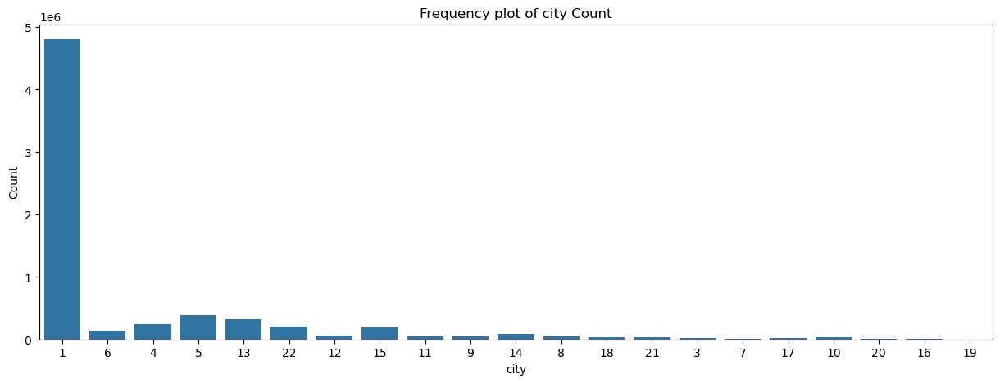

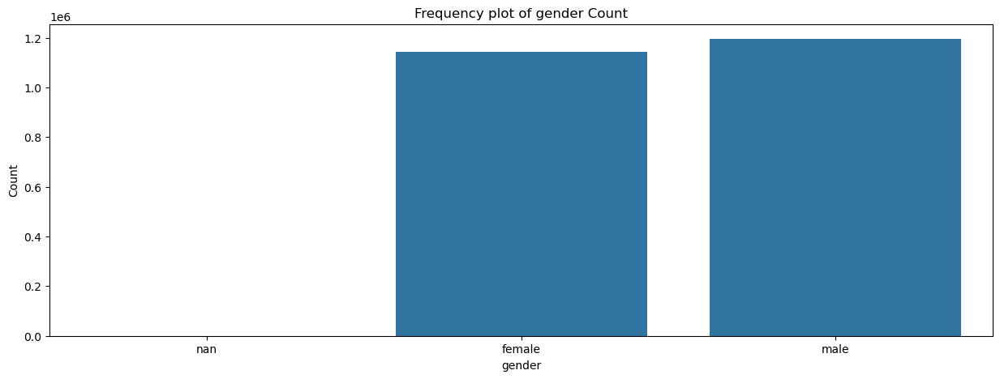

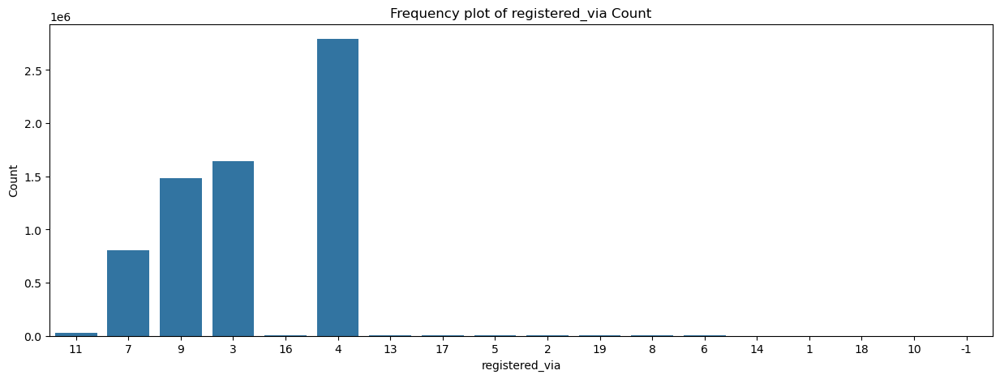

CPU times: user 27.4 s, sys: 4.04 s, total: 31.4 s
Wall time: 36.7 s


In [51]:
%%time
utils.count_plot(members, ['city','gender','registered_via'])

**Observation:**

* There are total of 21 Cities Encoded ( there is no City "2" in the data set). 
* There are Class of "3", "4", "7", "9", "11","13" listed as registration method.  

Kindly note that there is additional "10", and "16" class of cities listed in Member Data set but there are missing when we merged the data set ( see below). 
*  There are almost equal percentage of Male and Female, but more than half of the data is missing in gender field. We have see how to fill the missing entries or label them as third category. 

> Details of Registration init time can't be explored without converting the column to datatime.

In [53]:
%%time
members_new = utils.fix_time_in_df(members, 'registration_init_time', expand=True)

CPU times: user 6.2 s, sys: 2.46 s, total: 8.66 s
Wall time: 10.5 s


In [54]:
members_new.head()

,msno,city,bd,gender,registered_via,registration_init_time,registration_init_time_year,registration_init_time_month,registration_init_time_day
0,Rb9UwLQTrxzBVwCB6+bCcSQWZ9JiNLC9dXtM1oEsZA8=,1,0,NaN,11,2011-09-11,2011,9,Sunday
1,+tJonkh+O1CA796Fm5X60UMOtB6POHAwPjbTRVl/EuU=,1,0,NaN,7,2011-09-14,2011,9,Wednesday
2,cV358ssn7a0f7jZOwGNWS07wCKVqxyiImJUX6xcIwKw=,1,0,NaN,11,2011-09-15,2011,9,Thursday
3,9bzDeJP6sQodK73K5CBlJ6fgIQzPeLnRl0p5B77XP+g=,1,0,NaN,11,2011-09-15,2011,9,Thursday
4,WFLY3s7z4EZsieHCt63XrsdtfTEmJ+2PnnKLH5GY4Tk=,6,32,female,9,2011-09-15,2011,9,Thursday


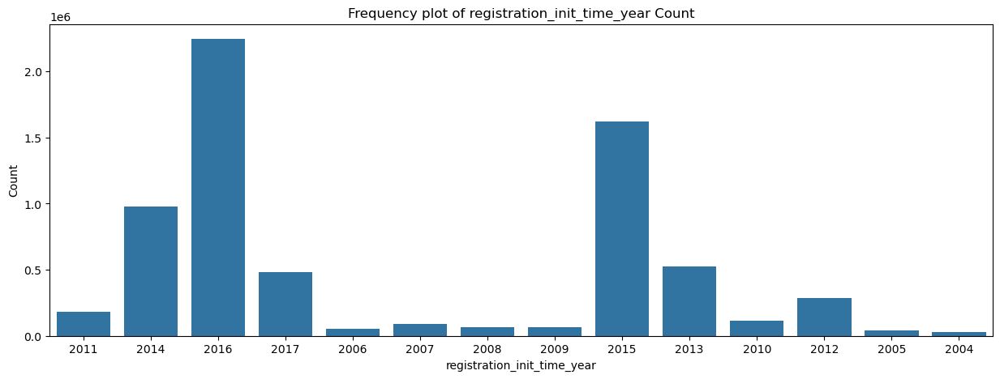

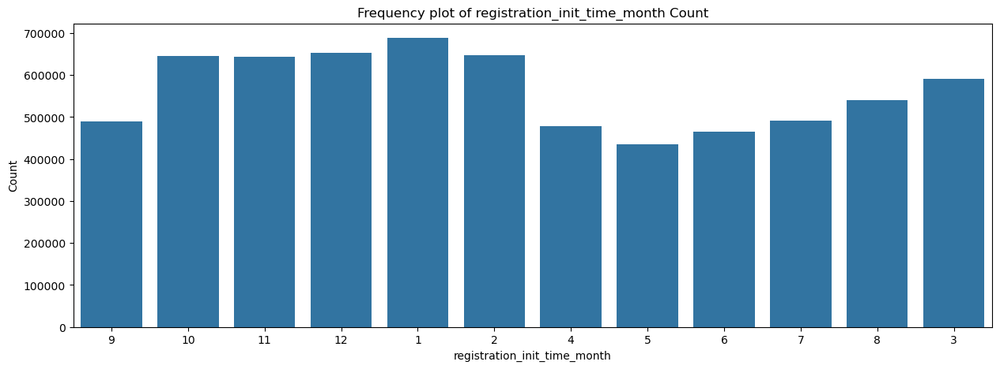

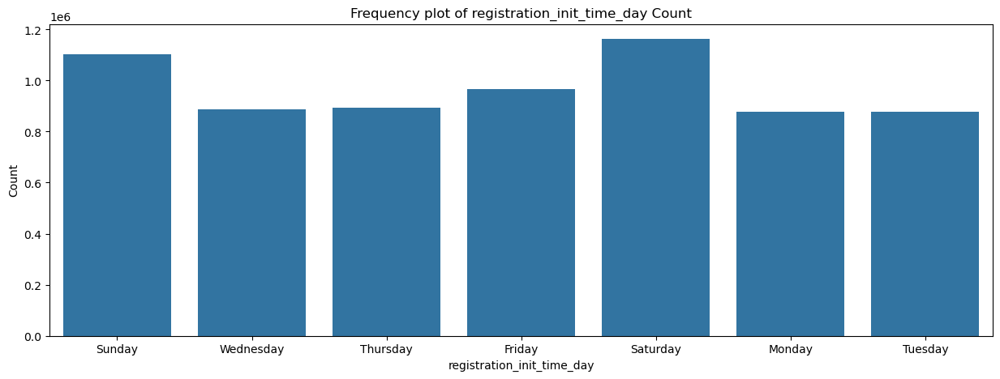

In [55]:
utils.count_plot(members_new,['registration_init_time_year','registration_init_time_month','registration_init_time_day'])

**Observations:**

* Registration trend has increased yearly, though there was a dip in 2014. Due to data upto few months in 2017, there is a dip.
* Registration monthly trends are high in year end and year starting months. In between there is a smooth valley formation.
* Registration daily trends are high on weekends.

In [57]:
%%time
members['registration_init_time'] = utils.fix_time_in_df(members, 'registration_init_time', expand=False)

CPU times: user 3.6 s, sys: 553 ms, total: 4.15 s
Wall time: 4.54 s


In [58]:
members.head()

,msno,city,bd,gender,registered_via,registration_init_time
0,Rb9UwLQTrxzBVwCB6+bCcSQWZ9JiNLC9dXtM1oEsZA8=,1,0,NaN,11,2011-09-11
1,+tJonkh+O1CA796Fm5X60UMOtB6POHAwPjbTRVl/EuU=,1,0,NaN,7,2011-09-14
2,cV358ssn7a0f7jZOwGNWS07wCKVqxyiImJUX6xcIwKw=,1,0,NaN,11,2011-09-15
3,9bzDeJP6sQodK73K5CBlJ6fgIQzPeLnRl0p5B77XP+g=,1,0,NaN,11,2011-09-15
4,WFLY3s7z4EZsieHCt63XrsdtfTEmJ+2PnnKLH5GY4Tk=,6,32,female,9,2011-09-15


### 1.3.1 EDA using Pandas Profiling

In [60]:
%%time
#taking sample
utils.get_data_profile(members, html_save_path=data_profile_path, 
                       embed_in_cell=False, take_sample=True, 
                      sample_frac=0.01, dataframe_name='Members')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 15.4 s, sys: 4.61 s, total: 20 s
Wall time: 16.5 s


('Your Data Profile has been saved at .. ',
 '/Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge/data/profile_report/Members_data_profile_1742077147.html')

**Observations**:


#Write your observations from the profile report created above
#### **1. Dataset Overview**
- **Number of Variables**: 6
- **Number of Observations**: 67,695
- **Total Missing Cells**: 44,312 (10.9% of data)
- **Duplicate Rows**: 0 (No duplicates)
- **Total Memory Usage**: 2.3 MB

#### **2. Variables Analysis**
- **Variable Types**:
  - 1 Text Variable
  - 3 Numeric Variables
  - 1 Categorical Variable
  - 1 DateTime Variable
- **Key Observations**:
  - `msno` is a unique identifier (100% distinct values).
  - `bd` (likely representing birthdate) has **67.1% zero values**, which might indicate missing or incorrect entries.
  - `gender` has **65.5% missing values**, making it unreliable for analysis.


#### **4. Correlation Insights**
- `bd` and `city` are **highly correlated**, indicating a possible relationship.
- High correlation can affect model performance if both are used as independent variables.

### **Key Takeaways**
- **Data Cleaning Needed**: Handle missing values in `gender` and `bd`.
- **Check Data Validity**: Investigate why `bd` has so many zero values.
- **Feature Engineering**: Consider if `city` and `bd` should be combined or one removed.


In [62]:
%%time
#taking sample
utils.get_data_profile(members, html_save_path=data_profile_path, 
                       embed_in_cell=False, take_sample=True, 
                      sample_frac=0.01, dataframe_name='transactions')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 13.4 s, sys: 1.85 s, total: 15.3 s
Wall time: 10.1 s


('Your Data Profile has been saved at .. ',
 '/Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge/data/profile_report/transactions_data_profile_1742077162.html')

**Observations**:
##Write your observations from the profile report created above

#### **1. Dataset Overview**
- **Number of Variables**: 6  
- **Number of Observations**: 67,695  
- **Missing Cells**: 44,157 (10.9% missing data)  
- **Duplicate Rows**: 0 (No duplicates)  
- **Total Memory Usage**: 2.3 MB  

#### **2. Variables Analysis**
- **Variable Types**:
  - **Text Variables**: 1
  - **Numeric Variables**: 3
  - **Categorical Variables**: 1
  - **DateTime Variables**: 1
- **Key Observations**:
  - `msno` is a unique identifier with **100% distinct values**.
  - `bd` (possibly birthdate or another numerical field) has **66.9% zero values**, indicating potential missing or invalid data.
  - `gender` has **65.2% missing values**, making it unreliable for analysis.

#### **3. Missing Values**
- **High Missingness**:
  - `gender`: 65.2% missing values.
  - `bd`: Contains a large number of zero values, likely meaning missing or incorrect data.

#### **4. Correlation Insights**
- `bd` and `city` are **highly correlated**, suggesting potential redundancy.
- The dataset contains **highly skewed** numeric variables.

#### **5. Potential Data Issues**
- **High Skewness**: `bd` has extreme skew (γ1 = 25.41).
- **Redundant Information**: `city` and `bd` may be redundant due to high correlation.
- **Data Quality Concerns**: The large number of zero values in `bd` and missing values in `gender` require handling.

### **Key Takeaways**
- **Data Cleaning Required**: Handle missing values in `gender` and `bd`.
- **Investigate Data Validity**: Why does `bd` have so many zero values?
- **Feature Engineering**: Consider whether `city` and `bd` should both be kept in the model.


In [64]:
%%time
utils.get_data_profile(train,html_save_path=None, 
                     embed_in_cell=True,take_sample=False, sample_frac=0.01, 
                dataframe_name='Train')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 23.5 s, sys: 5.18 s, total: 28.7 s
Wall time: 33.1 s


In [65]:
%%time
utils.get_data_profile(user_logs,html_save_path=data_profile_path, 
                     embed_in_cell=False,take_sample=True, sample_frac=0.001, 
                dataframe_name='user_logs')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 34.7 s, sys: 5.09 s, total: 39.8 s
Wall time: 25.3 s


('Your Data Profile has been saved at .. ',
 '/Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge/data/profile_report/user_logs_data_profile_1742077209.html')

**Observations:**


#Write your observations from the profile report created above



#### **Dataset Overview**
- **Number of Variables:** 9  
- **Number of Observations:** 18,396  
- **Total Memory Usage:** 682.7 KB  
- **Duplicate Rows:** 0 (0%)  
- **Missing Values:** 0 (0%)  

#### **Variable Types**
- **Text Columns:** 1  
- **Numeric Columns:** 8  

#### **High Correlations**
- `num_100` is highly correlated with `num_unq` and `total_secs`
- `num_25` is highly correlated with `num_50` and `num_unq`
- `num_50` is highly correlated with `num_25`
- `num_unq` is highly correlated with `num_100`, `num_25`, and `total_secs`
- `total_secs` is highly correlated with `num_100` and `num_unq`

#### **Data Skewness & Zero Values**
- `num_75` has high skewness (γ1 = 24.29)  
- `num_985` has high skewness (γ1 = 34.34)  
- `num_25`, `num_50`, `num_75`, and `num_985` contain a high percentage of zero values.  


### 1.5 Feature Engineering

#### Registration Features

In [69]:
utils.get_data_describe(members)

,city,bd,registered_via,registration_init_time
count,6769473.00,6769473.00,6769473.00,6769473
mean,3.85,9.80,5.25,2014-12-13 21:10:12.902246144
min,1.00,-7168.00,-1.00,2004-03-26 00:00:00
25%,1.00,0.00,4.00,2014-04-22 00:00:00
50%,1.00,0.00,4.00,2015-10-10 00:00:00
75%,4.00,21.00,7.00,2016-06-04 00:00:00
max,22.00,2016.00,19.00,2017-04-29 00:00:00
std,5.48,17.93,2.36,NaN


In [70]:
utils.get_data_na_values(members)

,%missing_values
msno,0.00
city,0.00
bd,0.00
gender,0.65
registered_via,0.00
registration_init_time,0.00


In [71]:
#Replacing missing values in gender
members['gender'] = utils.get_fill_na_dataframe(members, 'gender', value="others")

In [72]:
members.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6769473 entries, 0 to 6769472
Data columns (total 6 columns):
 #   Column                  Dtype         
---  ------                  -----         
 0   msno                    object        
 1   city                    int8          
 2   bd                      int16         
 3   gender                  object        
 4   registered_via          int8          
 5   registration_init_time  datetime64[ns]
dtypes: datetime64[ns](1), int16(1), int8(2), object(2)
memory usage: 180.8+ MB


In [73]:
members['registered_via'] = utils.get_convert_column_dtype(members, 'registered_via', data_type='str')
members['city'] = utils.get_convert_column_dtype(members, 'city', data_type='str')

In [90]:
members.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6769473 entries, 0 to 6769472
Data columns (total 6 columns):
 #   Column                  Dtype         
---  ------                  -----         
 0   msno                    object        
 1   city                    object        
 2   bd                      int16         
 3   gender                  object        
 4   registered_via          object        
 5   registration_init_time  datetime64[ns]
dtypes: datetime64[ns](1), int16(1), object(4)
memory usage: 271.1+ MB


In [92]:
members.head()

,msno,city,bd,gender,registered_via,registration_init_time
0,Rb9UwLQTrxzBVwCB6+bCcSQWZ9JiNLC9dXtM1oEsZA8=,1,0,others,11,2011-09-11
1,+tJonkh+O1CA796Fm5X60UMOtB6POHAwPjbTRVl/EuU=,1,0,others,7,2011-09-14
2,cV358ssn7a0f7jZOwGNWS07wCKVqxyiImJUX6xcIwKw=,1,0,others,11,2011-09-15
3,9bzDeJP6sQodK73K5CBlJ6fgIQzPeLnRl0p5B77XP+g=,1,0,others,11,2011-09-15
4,WFLY3s7z4EZsieHCt63XrsdtfTEmJ+2PnnKLH5GY4Tk=,6,32,female,9,2011-09-15


#### Transactional features

The data here is present in one-many format, as one user can have multiple transaction samples. Therefore while joining the entire data, we need to convert the transactions data in one-one format.
But before that let's format the data and process it

In [95]:
utils.get_data_describe(transactions)

,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date,membership_expire_date,is_cancel
count,1431009.00,1431009.00,1431009.00,1431009.00,1431009.00,1431009.00,1431009.00,1431009.00
mean,37.92,66.02,281.79,281.32,0.79,20168484.54,20171100.68,0.02
std,4.96,102.49,435.19,435.42,0.41,4858.80,3032.37,0.15
min,2.00,0.00,0.00,0.00,0.00,20150101.00,20160419.00,0.00
25%,36.00,30.00,99.00,99.00,1.00,20170228.00,20170410.00,0.00
50%,40.00,30.00,149.00,149.00,1.00,20170311.00,20170421.00,0.00
75%,41.00,30.00,149.00,149.00,1.00,20170323.00,20170501.00,0.00
max,41.00,450.00,2000.00,2000.00,1.00,20170331.00,20361015.00,1.00


In [97]:
#Missing Values
utils.get_data_na_values(transactions)

,%missing_values
msno,0.0
payment_method_id,0.0
payment_plan_days,0.0
plan_list_price,0.0
actual_amount_paid,0.0
is_auto_renew,0.0
transaction_date,0.0
membership_expire_date,0.0
is_cancel,0.0


In [99]:
%%time
transactions['transaction_date'] = utils.fix_time_in_df(transactions, 'transaction_date', expand=False)
transactions['membership_expire_date'] = utils.fix_time_in_df(transactions, 'membership_expire_date', expand=False)

CPU times: user 1.62 s, sys: 214 ms, total: 1.84 s
Wall time: 2.06 s


In [101]:
transactions.head()

,msno,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date,membership_expire_date,is_cancel
0,++6eU4LsQ3UQ20ILS7d99XK8WbiVgbyYL4FUgzZR134=,32,90,298,298,0,2017-01-31,2017-05-04,0
1,++lvGPJOinuin/8esghpnqdljm6NXS8m8Zwchc7gOeA=,41,30,149,149,1,2015-08-09,2019-04-12,0
2,+/GXNtXWQVfKrEDqYAzcSw2xSPYMKWNj22m+5XkVQZc=,36,30,180,180,1,2017-03-03,2017-04-22,0
3,+/w1UrZwyka4C9oNH3+Q8fUf3fD8R3EwWrx57ODIsqk=,36,30,180,180,1,2017-03-29,2017-03-31,1
4,+00PGzKTYqtnb65mPKPyeHXcZEwqiEzktpQksaaSC3c=,41,30,99,99,1,2017-03-23,2017-04-23,0


In [103]:
transaction_base = utils.get_groupby(transactions,'msno', agg_dict=None, agg_func = 'mean', simple_agg_flag=True, reset_index=True)
transaction_base.head()

,msno,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date,membership_expire_date,is_cancel
0,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,22.0,395.0,1599.0,1599.0,0.0,2016-10-23 00:00:00,2018-02-06,0.0
1,+++hVY1rZox/33YtvDgmKA2Frg/2qhkz12B9ylCvh8o=,41.0,30.0,99.0,99.0,1.0,2017-03-15 00:00:00,2017-04-15,0.0
2,+++l/EXNMLTijfLBa8p2TUVVVp2aFGSuUI/h7mLmthw=,39.0,30.0,149.0,149.0,1.0,2017-03-15 12:00:00,2017-05-04,0.0
3,+++snpr7pmobhLKUgSHTv/mpkqgBT0tQJ0zQj6qKrqc=,41.0,30.0,149.0,149.0,1.0,2017-03-26 00:00:00,2017-04-26,0.0
4,++/9R3sX37CjxbY/AaGvbwr3QkwElKBCtSvVzhCBDOk=,41.0,30.0,149.0,149.0,1.0,2017-03-15 00:00:00,2017-04-15,0.0


In [105]:
agg_dict = { 'transaction_date':'max', 'membership_expire_date':'max' }
transaction_date = utils.get_groupby(transactions,'msno', agg_dict=agg_dict, agg_func = 'mean', simple_agg_flag=False, reset_index=True)
transaction_date.head()

,msno,transaction_date,membership_expire_date
0,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,2016-10-23,2018-02-06
1,+++hVY1rZox/33YtvDgmKA2Frg/2qhkz12B9ylCvh8o=,2017-03-15,2017-04-15
2,+++l/EXNMLTijfLBa8p2TUVVVp2aFGSuUI/h7mLmthw=,2017-03-31,2017-05-19
3,+++snpr7pmobhLKUgSHTv/mpkqgBT0tQJ0zQj6qKrqc=,2017-03-26,2017-04-26
4,++/9R3sX37CjxbY/AaGvbwr3QkwElKBCtSvVzhCBDOk=,2017-03-15,2017-04-15


In [106]:
transaction_final = utils.get_merge(transaction_base, transaction_date, on = 'msno') 
transaction_final.head()

,msno,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date_x,membership_expire_date_x,is_cancel,transaction_date_y,membership_expire_date_y
0,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,22.0,395.0,1599.0,1599.0,0.0,2016-10-23 00:00:00,2018-02-06,0.0,2016-10-23,2018-02-06
1,+++hVY1rZox/33YtvDgmKA2Frg/2qhkz12B9ylCvh8o=,41.0,30.0,99.0,99.0,1.0,2017-03-15 00:00:00,2017-04-15,0.0,2017-03-15,2017-04-15
2,+++l/EXNMLTijfLBa8p2TUVVVp2aFGSuUI/h7mLmthw=,39.0,30.0,149.0,149.0,1.0,2017-03-15 12:00:00,2017-05-04,0.0,2017-03-31,2017-05-19
3,+++snpr7pmobhLKUgSHTv/mpkqgBT0tQJ0zQj6qKrqc=,41.0,30.0,149.0,149.0,1.0,2017-03-26 00:00:00,2017-04-26,0.0,2017-03-26,2017-04-26
4,++/9R3sX37CjxbY/AaGvbwr3QkwElKBCtSvVzhCBDOk=,41.0,30.0,149.0,149.0,1.0,2017-03-15 00:00:00,2017-04-15,0.0,2017-03-15,2017-04-15


In [109]:
utils.get_data_describe(transaction_final)

,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date_x,membership_expire_date_x,is_cancel,transaction_date_y,membership_expire_date_y
count,1197050.00,1197050.00,1197050.00,1197050.0,1197050.00,1197050,1197050,1197050.00,1197050,1197050
mean,37.83,70.60,299.56,299.2,0.77,2017-02-19 21:15:37.166964992,2017-05-09 05:01:53.199824128,0.02,2017-02-23 13:37:13.452570112,2017-05-12 13:05:17.141639424
min,2.00,0.00,0.00,0.0,0.00,2015-01-02 00:00:00,2016-04-19 12:00:00,0.00,2015-01-02 00:00:00,2016-04-20 00:00:00
25%,36.00,30.00,99.00,99.0,1.00,2017-03-04 00:00:00,2017-04-10 00:00:00,0.00,2017-03-05 00:00:00,2017-04-10 00:00:00
50%,40.00,30.00,149.00,149.0,1.00,2017-03-14 00:00:00,2017-04-19 00:00:00,0.00,2017-03-15 00:00:00,2017-04-20 00:00:00
75%,41.00,30.00,149.00,149.0,1.00,2017-03-21 00:00:00,2017-04-30 00:00:00,0.00,2017-03-25 00:00:00,2017-04-30 00:00:00
max,41.00,450.00,2000.00,2000.0,1.00,2017-03-31 00:00:00,2025-10-27 10:17:08.571428608,1.00,2017-03-31 00:00:00,2036-10-15 00:00:00
std,4.98,107.38,457.31,457.5,0.42,NaN,NaN,0.11,NaN,NaN


In [111]:
%%time
utils.get_data_profile(transaction_final,html_save_path=None, 
                     embed_in_cell=True,take_sample=False, sample_frac=0.01, 
                dataframe_name='Transaction_Final')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 1min 4s, sys: 11.9 s, total: 1min 16s
Wall time: 1min 6s


**Observations**:


#Write your observations from the profile report created above


- **Total records:** 1,197,050  
- **Variables:** 11  
- **Missing values:** None  
- **Duplicate rows:** None  
- **Memory usage:** 100.5 MiB  

#### **Variable Breakdown:**
- **1 Text Variable:**
  - `msno`: Unique identifier (100% distinct values)  

- **6 Numeric Variables:**
  - `payment_method_id`: 346 unique values, mean = 37.83  
  - `payment_plan_days`: 608 unique values, mean = 70.6, max = 450  
  - `plan_list_price`: 1,677 unique values, mean = 299.56, max = 2000  
  - `actual_amount_paid`: 1,422 unique values, mean = 299.2, max = 2000  
  - `is_auto_renew`: Binary, 22.8% are `0` (not auto-renewed)  
  - `is_cancel`: Binary, 97.1% are `0` (not canceled)  

- **4 DateTime Variables:**
  - `transaction_date_x`, `transaction_date_y`: Range from 2015-01-02 to 2017-03-31  
  - `membership_expire_date_x`, `membership_expire_date_y`: Maximum expiry date up to **2036-10-15**  

This dataset likely tracks **subscription-based transactions**, focusing on **payment details, renewal status, and membership duration**.


#### User Behavioural Features

Like the transactions data, the data here is also present in one-many format.  Therefore this data also has to converted in one-one format.

In [115]:
utils.get_data_describe(user_logs)

,date,num_25,num_50,num_75,num_985,num_100,num_unq,total_secs
count,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00
mean,20170316.09,6.19,1.51,0.94,1.08,30.28,29.04,7904.81
std,8.92,13.43,3.91,1.92,3.52,42.04,32.20,9743.00
min,20170301.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
25%,20170308.00,0.00,0.00,0.00,0.00,7.00,8.00,1959.94
50%,20170316.00,2.00,1.00,0.00,0.00,17.00,18.00,4582.99
75%,20170324.00,7.00,2.00,1.00,1.00,37.00,38.00,9848.44
max,20170331.00,5639.00,912.00,508.00,1561.00,41107.00,4925.00,9194059.00


In [116]:
#Missing Values
utils.get_data_na_values(user_logs)

,%missing_values
msno,0.0
date,0.0
num_25,0.0
num_50,0.0
num_75,0.0
num_985,0.0
num_100,0.0
num_unq,0.0
total_secs,0.0


In [117]:
user_logs_transformed = utils.get_fix_skew_with_log(user_logs, ['num_25','num_50','num_75','num_985','num_100','num_unq','total_secs'], 
                                              replace_inf = True, replace_inf_with = 0)
user_logs_transformed.head()

,num_25,num_50,num_75,num_985,num_100,num_unq,total_secs,msno,date
0,2.079442,1.386294,0.000000,0.000000,3.044522,2.890372,8.749776,u9E91QDTvHLq6NXjEaWv8u4QIqhrHk72kE+w31Gnhdg=,20170331
1,0.693147,0.693147,0.000000,0.000000,2.197225,2.397895,7.779341,nTeWW/eOZA/UHKdD5L7DEqKKFTjaAj3ALLPoAWsU8n0=,20170330
2,3.951244,1.098612,1.609438,1.098612,4.430817,4.700480,10.052052,2UqkWXwZbIjs03dHLU9KHJNNEvEkZVzm69f3jCS+uLI=,20170331
3,5.170484,1.386294,0.693147,0.693147,2.944439,5.252274,8.867914,ycwLc+m2O0a85jSLALtr941AaZt9ai8Qwlg9n0Nql5U=,20170331
4,0.693147,0.000000,0.000000,0.000000,4.718499,4.532599,10.254199,EGcbTofOSOkMmQyN1NMLxHEXJ1yV3t/JdhGwQ9wXjnI=,20170331


In [119]:
utils.get_data_describe(user_logs_transformed)

,num_25,num_50,num_75,num_985,num_100,num_unq,total_secs,date
count,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00,18396362.00
mean,1.07,0.35,0.22,0.25,2.71,2.79,8.31,20170316.09
std,1.17,0.59,0.46,0.49,1.29,1.15,1.28,8.92
min,0.00,0.00,0.00,0.00,0.00,0.00,-6.91,20170301.00
25%,0.00,0.00,0.00,0.00,1.95,2.08,7.58,20170308.00
50%,0.69,0.00,0.00,0.00,2.83,2.89,8.43,20170316.00
75%,1.95,0.69,0.00,0.00,3.61,3.64,9.20,20170324.00
max,8.64,6.82,6.23,7.35,10.62,8.50,16.03,20170331.00


In [120]:
user_logs_transformed.drop('date', axis=1, inplace= True)

In [121]:
user_logs_transformed_final = utils.get_groupby(user_logs_transformed,'msno', agg_dict=None, agg_func = 'mean', simple_agg_flag=True, reset_index=True)
user_logs_transformed_final.head()

,msno,num_25,num_50,num_75,num_985,num_100,num_unq,total_secs
0,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,0.865005,0.053319,0.026660,0.000000,2.225973,2.375629,7.785638
1,+++hVY1rZox/33YtvDgmKA2Frg/2qhkz12B9ylCvh8o=,1.583487,0.865270,0.705354,1.235157,2.699058,3.232693,8.572131
2,+++l/EXNMLTijfLBa8p2TUVVVp2aFGSuUI/h7mLmthw=,0.386705,0.113502,0.131746,0.063991,2.413424,2.485538,7.902219
3,+++snpr7pmobhLKUgSHTv/mpkqgBT0tQJ0zQj6qKrqc=,1.877399,1.184630,0.973230,0.800436,2.608808,3.250370,8.476251
4,++/9R3sX37CjxbY/AaGvbwr3QkwElKBCtSvVzhCBDOk=,0.959729,0.202969,0.397272,0.338684,2.303380,1.616476,7.834351


In [ ]:
%%time
utils.get_data_profile(user_logs_transformed_final,html_save_path=None, 
                     embed_in_cell=True,take_sample=False, sample_frac=0.01, 
                dataframe_name='user_logs_transformed_final')

**Observations**:


#Write your observations from the profile report created above


#### **Overview:**
- **Total records:** 1,103,894  
- **Variables:** 8  
- **Missing values:** None  
- **Duplicate rows:** None  
- **Memory usage:** 42.1 MiB  

#### **Variable Breakdown:**
- **1 Text Variable:**
  - `msno`: Unique identifier (100% distinct values)  

- **7 Numeric Variables:**
  - `num_25`: 470,252 unique values, mean = 0.99, 7.5% zeros, max = 6.75  
  - `num_50`: 115,735 unique values, mean = 0.31, 22.1% zeros, max = 6.11  
  - `num_75`: 49,333 unique values, mean = 0.19, 30.1% zeros, max = 5.05  
  - `num_985`: 59,484 unique values, mean = 0.20, 30.3% zeros, max = 5.42  
  - `num_100`: 844,241 unique values, mean = 2.34, 4.9% zeros, max = 7.77  
  - `num_unq`: 822,691 unique values, mean = 2.52, 2.1% zeros, max = 6.55  
  - `total_secs`: 968,442 unique values, mean = 7.93, max = 13.19, minimal negatives (<0.1%)  

#### **Key Insights:**
- **No missing or duplicate values**, ensuring high data integrity.  
- **High uniqueness in user data**, particularly in `msno`, `num_100`, and `total_secs`.  
- **Zero values appear frequently** in `num_75` and `num_985`, suggesting many users do not engage fully.  
- **Total listening time (`total_secs`) shows occasional negative values**, which may require further investigation.  


### 1.6 Joining the dataset

In [123]:
print(members.shape)
print(train.shape)
print(transaction_final.shape)
print(user_logs_transformed_final.shape)

(6769473, 6)
(970960, 2)
(1197050, 11)
(1103894, 8)


In [129]:
%%time
train_df_v01 = utils.get_merge(members, train, on='msno', axis=1, how='inner')
train_df_v02 = utils.get_merge(train_df_v01, transaction_final, on='msno', axis=1, how='inner')
train_df_final = utils.get_merge(train_df_v02, user_logs_transformed_final, on='msno', axis=1, how='inner')
train_df_final.head()

CPU times: user 15.3 s, sys: 10.5 s, total: 25.8 s
Wall time: 37.3 s


,msno,city,bd,gender,registered_via,registration_init_time,is_churn,payment_method_id,payment_plan_days,plan_list_price,...,is_cancel,transaction_date_y,membership_expire_date_y,num_25,num_50,num_75,num_985,num_100,num_unq,total_secs
0,+tJonkh+O1CA796Fm5X60UMOtB6POHAwPjbTRVl/EuU=,1,0,others,7,2011-09-14,0,41.0,30.0,129.0,...,0.0,2017-03-27,2017-04-28,1.948915,0.729391,0.670692,0.520508,3.574015,3.385445,9.198797
1,yLkV2gbZ4GLFwqTOXLVHz0VGrMYcgBGgKZ3kj9RiYu8=,4,30,male,9,2011-09-16,0,39.0,30.0,149.0,...,0.0,2017-03-31,2017-05-17,0.622945,0.298627,0.183102,0.597253,4.188308,2.327496,9.724874
2,I0yFvqMoNkM8ZNHb617e1RBzIS/YRKemHO7Wj13EtA0=,13,63,male,9,2011-09-18,0,40.0,30.0,149.0,...,0.0,2017-03-27,2017-04-26,0.816608,0.391625,0.166430,0.391625,2.136706,2.576414,7.515067
3,OoDwiKZM+ZGr9P3fRivavgOtglTEaNfWJO4KaJcTTts=,1,0,others,7,2011-09-18,1,41.0,30.0,149.0,...,0.0,2017-03-26,2017-04-27,0.231049,0.231049,0.000000,0.000000,1.723495,2.210667,7.490002
4,4De1jAxNRABoyRBDZ82U0yEmzYkqeOugRGVNIf92Xb8=,4,28,female,9,2011-09-20,0,36.0,30.0,180.0,...,0.0,2017-03-03,2017-04-02,0.317805,0.000000,0.000000,0.069315,2.090351,1.565339,7.115603


In [131]:
train_df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 725722 entries, 0 to 725721
Data columns (total 24 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   msno                      725722 non-null  object        
 1   city                      725722 non-null  object        
 2   bd                        725722 non-null  int16         
 3   gender                    725722 non-null  object        
 4   registered_via            725722 non-null  object        
 5   registration_init_time    725722 non-null  datetime64[ns]
 6   is_churn                  725722 non-null  int64         
 7   payment_method_id         725722 non-null  float64       
 8   payment_plan_days         725722 non-null  float64       
 9   plan_list_price           725722 non-null  float64       
 10  actual_amount_paid        725722 non-null  float64       
 11  is_auto_renew             725722 non-null  float64       
 12  tr

In [144]:
%%time
utils.get_data_profile(train_df_final,html_save_path=None, 
                     embed_in_cell=True,take_sample=False, sample_frac=0.01, 
                dataframe_name='train_df_final')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 3min 39s, sys: 39.3 s, total: 4min 19s
Wall time: 3min 56s


**Observations**:

#Write your observations from the profile report created above

- **Number of variables:** 19
- **Number of observations:** 725,722
- **Missing cells:** 0 (0.0%)
- **Duplicate rows:** 0 (0.0%)
- **Total size in memory:** 84.4 MiB
- **Average record size in memory:** 122.0 B

### **Variable Types:**
- **Text:** 1
- **Numeric:** 15
- **Categorical:** 3

## **Variables Summary**

### **Text Variable:**
- **msno:** Unique identifier with 725,722 distinct values (100%).

### **Categorical Variables:**
- **gender:**
  - Distinct values: 3 (others, male, female)
  - Memory size: 5.5 MiB
  - Distribution: 
    - Others: 381,807
    - Male: 179,846
    - Female: 164,069

- **registered_via:**
  - Distinct values: 5
  - Memory size: 5.5 MiB
  - Distribution:
    - 7: 380,005
    - 9: 207,081
    - 3: 91,727
    - 4: 43,945
    - 13: 2,964

- **is_churn:**
  - Distinct values: 2
  - Memory size: 5.5 MiB
  - Distribution:
    - 0: 679,119 (non-churned)
    - 1: 46,603 (churned)

### **Numeric Variables:**
- **city:**
  - Distinct values: 21
  - Mean: 6.197
  - Min: 1, Max: 22
  
- **bd (birth year):**
  - Distinct values: 217
  - Mean: 14.205
  - Min: -3152, Max: 2016
  - Zeros: 52.8%

- **payment_method_id:**
  - Distinct values: 253
  - Mean: 38.592
  - Min: 3, Max: 41
  
- **payment_plan_days:**
  - Distinct values: 327
  - Mean: 34.687
  - Min: 1, Max: 450

- **plan_list_price:**
  - Distinct values: 1189
  - Mean: 152.482
  - Min: 0, Max: 2000
  - Zeros: 0.1%

- **actual_amount_paid:**
  - Distinct values: 984
  - Mean: 152.111
  - Min: 0, Max: 2000
  - Zeros: 0.2%

- **is_auto_renew:**
  - Mean: 0.887
  - Zeros: 11.1%

- **is_cancel:**
  - Mean: 0.018
  - Zeros: 96.8%

- **num_25, num_50, num_75, num_985, num_100, num_unq, total_secs:**
  - Various distributions, all highly correlated.
  - High percentage of zeros in num_50 (18.8%) and num_75 (26.6%).
  - Negative values observed in total_secs.

## **Interactions & Correlations**
- Several numeric variables show **high correlation**, particularly:
  - **num_25, num_50, num_75, num_985, num_100, num_unq, and total_secs.**
  - High correlation with **is_churn** (target variable).

## **Missing Values Analysis**
- **No missing values** in the dataset.



In [135]:
train_df_final.drop(['registration_init_time','transaction_date_y','transaction_date_x','membership_expire_date_x','membership_expire_date_y'],axis=1,inplace=True)

In [ ]:
#members_v01_sample_joinfinal.drop(['registration_init_time','date','transaction_date','membership_expire_date'],axis=1,inplace=True)

In [137]:
train_df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 725722 entries, 0 to 725721
Data columns (total 19 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   msno                725722 non-null  object 
 1   city                725722 non-null  object 
 2   bd                  725722 non-null  int16  
 3   gender              725722 non-null  object 
 4   registered_via      725722 non-null  object 
 5   is_churn            725722 non-null  int64  
 6   payment_method_id   725722 non-null  float64
 7   payment_plan_days   725722 non-null  float64
 8   plan_list_price     725722 non-null  float64
 9   actual_amount_paid  725722 non-null  float64
 10  is_auto_renew       725722 non-null  float64
 11  is_cancel           725722 non-null  float64
 12  num_25              725722 non-null  float32
 13  num_50              725722 non-null  float32
 14  num_75              725722 non-null  float32
 15  num_985             725722 non-nul

### 1.6.1 Saving the dataset

In [ ]:
#this function is also available in utils.py
# import time
# def get_save_intermediate_data(dataframe, path, filename="data_interim"):
#     filename = filename+"_"+str(int(time.time()))+".csv"
#     dataframe.to_csv(path+filename)
#     return "Data Saved Here :",path+filename

In [139]:
%%time
utils.get_save_intermediate_data(train_df_final, path=intermediate_data_path, filename="final_train_data_interim")

CPU times: user 12.1 s, sys: 2.01 s, total: 14.1 s
Wall time: 16.1 s


('Data Saved Here :',
 '/Users/arunprakash/Downloads/Python/practise/MLops/Churn-Prediction-Challenge/data/interim/final_train_data_interim_1742078542.csv')